## 33002 Machine Learning Project 1: Customer Segmentation Classification 
- Original dataset: https://www.kaggle.com/datasets/kaushiksuresh147/customer-segmentation
- Group Members: Felix Wang, Jun Tan, Liwei Xu

The tasks are to:
- train a multi-class classification model for customer segmentation of an automobile company to enter new markets
- help the manager to predict the right group of the new customers

### Import libraries 

In [1]:
# scientific calculation packages
import numpy as np 
import pandas as pd 
from collections import Counter

# visualization packages
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline

# machine learning packages
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import graphviz 
from sklearn.model_selection import GridSearchCV

### Load and explore the data

In [2]:
# Read data from csv file to a pandas dataframe
train_df = pd.read_csv('/Users/wangzijie/Desktop/UChicago Winter/MACS 33002 Machine Learning/Group Project/Train.csv')
test_df = pd.read_csv('/Users/wangzijie/Desktop/UChicago Winter/MACS 33002 Machine Learning/Group Project/Test.csv')

# check the data size
train_df.shape, test_df.shape


((8068, 11), (2627, 11))

In [3]:
# explore the number of instances from each class 
train_df['Segmentation'].value_counts()


D    2268
A    1972
C    1970
B    1858
Name: Segmentation, dtype: int64

In [4]:
test_df['Segmentation'].value_counts()


A    846
D    759
B    550
C    472
Name: Segmentation, dtype: int64

In the original training sample, D is roughly 28.1% of all the observations, A is 24.4% of all the observations, C is also 24.4%, and B is 23.0% of all the observations. Therefore, our target variable 'Segmentation' in the original training dataset is not perfectly balanced. (If perfectly balanced, with four categories in our target variable, each category should be roughly 25% of all the observations.) But it seems fine at least for the training sample because the percentage of the 4 categories are close to 25%. The most important issue is that the target variable in the testing data is very imbalanced. To balance the target variable 'Segmentation', both the training and testing data need to be balanced since we want to ensure that the distribution of categories in the target variable is representative of the overall distribution of the target variable. For testing data, A is 32.2% of all the observations, D is 28.9%, B is 20.9%, and C is 18.0% of all the observations. The testing data is more imbalanced than the training data and may negatively affect the accuracy of the model's performance and prediction.  


#### Data concatenation

- We found the testing set is not balanced which may negatively affect our evaluation on model performance. So to address the issue and make the testing set more balanced, we decided to combine the training and testing set and resample the training and testing set later.

In [5]:
df = pd.concat([train_df, test_df], ignore_index=True)
df.shape

(10695, 11)

In [6]:
# check data distribution in each class
df['Segmentation'].value_counts()

D    3027
A    2818
C    2442
B    2408
Name: Segmentation, dtype: int64

In [7]:
# get an overview of the top-n rows
df.head()

,ID,Gender,Ever_Married,Age,Graduated,Profession,Work_Experience,Spending_Score,Family_Size,Var_1,Segmentation
0,462809,Male,No,22,No,Healthcare,1.0,Low,4.0,Cat_4,D
1,462643,Female,Yes,38,Yes,Engineer,NaN,Average,3.0,Cat_4,A
2,466315,Female,Yes,67,Yes,Engineer,1.0,Low,1.0,Cat_6,B
3,461735,Male,Yes,67,Yes,Lawyer,0.0,High,2.0,Cat_6,B
4,462669,Female,Yes,40,Yes,Entertainment,NaN,High,6.0,Cat_6,A


In [8]:
# attributes for each data sample
df.columns

Index(['ID', 'Gender', 'Ever_Married', 'Age', 'Graduated', 'Profession',
       'Work_Experience', 'Spending_Score', 'Family_Size', 'Var_1',
       'Segmentation'],
      dtype='object')

In [9]:
# get basic information about each feature
df.info()
#df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10695 entries, 0 to 10694
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ID               10695 non-null  int64  
 1   Gender           10695 non-null  object 
 2   Ever_Married     10505 non-null  object 
 3   Age              10695 non-null  int64  
 4   Graduated        10593 non-null  object 
 5   Profession       10533 non-null  object 
 6   Work_Experience  9597 non-null   float64
 7   Spending_Score   10695 non-null  object 
 8   Family_Size      10247 non-null  float64
 9   Var_1            10587 non-null  object 
 10  Segmentation     10695 non-null  object 
dtypes: float64(2), int64(2), object(7)
memory usage: 919.2+ KB


### Date preprocessing
Now we can keep further exploring our dataset with 10,695 samples and 11 attributes.

In this section, we focus on making the data ready to use for ML models. It includes:
- Data cleaning (missing values, data types, outliers)
- Data transformation (numerical data normalization)
- Feature engineering (categorical data, numerical data)

#### Data cleaning

In [10]:
# check missing values
null_sum = df.isnull().sum()
null_sum

ID                    0
Gender                0
Ever_Married        190
Age                   0
Graduated           102
Profession          162
Work_Experience    1098
Spending_Score        0
Family_Size         448
Var_1               108
Segmentation          0
dtype: int64

We found that among 11 attributes in our dataset, there are missing values in 6 of them including "Ever_Married", "Graduated", "Profession", "Work_Experience", "Family_Size", and "Var_1". Especially attributes "Work_Experience" and "Family_Size" has a large number of missing values. Therefore, we can't just simply drop all the missing values using dropna() function. We have to fill the missing values with some meaningful values such as mean and mode. 

In [11]:
# fill missing values in column "Work_Experience" with mean
df['Work_Experience'].fillna(df['Work_Experience'].mean(), inplace=True)

# check missing values in 'Work_Experience' after fillna
df['Work_Experience'].isnull().sum()

0

In [12]:
#fill missing values in column "Family_Size"
df['Family_Size'].fillna(df['Family_Size'].mean(), inplace=True)
df['Family_Size'].isnull().sum()

0

In [13]:
#fill missing values in column "Ever_Married" with the majority's response 
df['Ever_Married'].fillna(df['Ever_Married'].mode()[0], inplace=True)
df['Ever_Married'].isnull().sum()

0

In [14]:
#fill missing values in column "Graduated" with the majority's response 
df['Graduated'].fillna(df['Graduated'].mode()[0], inplace=True)
df['Graduated'].isnull().sum()

0

In [15]:
#fill missing values in column "Profession" with the majority's response 
df['Profession'].fillna(df['Profession'].mode()[0], inplace=True)
df['Profession'].isnull().sum()

0

In [16]:
#fill missing values in column "Var_1" with the majority's response 
df['Var_1'].fillna(df['Var_1'].mode()[0], inplace=True)
df['Var_1'].isnull().sum()

0

In [17]:
# drop unique values like "ID" because it has no prediction ability and not useful for classification
df.drop(["ID"], axis=1, inplace=True)
df.shape

(10695, 10)

In [18]:
# double check if all missing values are addressed
df.isnull().sum()

Gender             0
Ever_Married       0
Age                0
Graduated          0
Profession         0
Work_Experience    0
Spending_Score     0
Family_Size        0
Var_1              0
Segmentation       0
dtype: int64

In [19]:
# check the data types
df.dtypes 

Gender              object
Ever_Married        object
Age                  int64
Graduated           object
Profession          object
Work_Experience    float64
Spending_Score      object
Family_Size        float64
Var_1               object
Segmentation        object
dtype: object

According to the table above, we found that "Age", "Work_Experience" and "Family_Size" are numerical variables. The rest including "Gender", "Ever_Married", "Graduated", "Profession", "Spending_Score", "Var_1" and "Segmentation" are all categorical variables. They are now categorized as object because by default, Pandas will store strings using the object dtype. In order to make these variables easy to be encoded in our later feature engineering process, we decided to organize these variables into categorical data types. 

##### process categorical data

In [20]:
# Convert the following columns to categorical data types 
cat_col = ["Gender", "Ever_Married", "Graduated", "Profession", "Spending_Score", "Var_1", "Segmentation"]
df[cat_col] = df[cat_col].astype('category')
df[cat_col]

,Gender,Ever_Married,Graduated,Profession,Spending_Score,Var_1,Segmentation
0,Male,No,No,Healthcare,Low,Cat_4,D
1,Female,Yes,Yes,Engineer,Average,Cat_4,A
2,Female,Yes,Yes,Engineer,Low,Cat_6,B
3,Male,Yes,Yes,Lawyer,High,Cat_6,B
4,Female,Yes,Yes,Entertainment,High,Cat_6,A
...,...,...,...,...,...,...,...
10690,Male,No,No,Healthcare,Low,Cat_6,B
10691,Female,No,Yes,Doctor,Low,Cat_6,A
10692,Female,No,Yes,Entertainment,Low,Cat_6,C
10693,Male,Yes,Yes,Executive,High,Cat_4,C


In [21]:
# the following columns now all have the categorical data types
df[cat_col].dtypes

Gender            category
Ever_Married      category
Graduated         category
Profession        category
Spending_Score    category
Var_1             category
Segmentation      category
dtype: object

In [22]:
# count the #samples fall into each category of attribute "Gender"
df['Gender'].value_counts() 

Male      5841
Female    4854
Name: Gender, dtype: int64

In [23]:
# count the #samples fall into each category of attribute "Gender"
df['Ever_Married'].value_counts()

Yes    6353
No     4342
Name: Ever_Married, dtype: int64

In [24]:
# count the #samples fall into each category of attribute "Graduated"
df['Graduated'].value_counts()

Yes    6672
No     4023
Name: Graduated, dtype: int64

In [25]:
# count the #samples fall into each category of attribute "Profession"
df['Profession'].value_counts()

Artist           3480
Healthcare       1750
Entertainment    1250
Engineer          935
Doctor            930
Lawyer            844
Executive         775
Marketing         403
Homemaker         328
Name: Profession, dtype: int64

In [26]:
# count the #samples fall into each category of attribute "Spending_Score"
df['Spending_Score'].value_counts()

Low        6494
Average    2599
High       1602
Name: Spending_Score, dtype: int64

In [27]:
# count the #samples fall into each category of attribute "Var_1"
df['Var_1'].value_counts()

Cat_6    7018
Cat_4    1475
Cat_3    1089
Cat_2     563
Cat_7     269
Cat_1     167
Cat_5     114
Name: Var_1, dtype: int64

In [28]:
# count the #samples fall into each category of attribute "Segmentation"
df['Segmentation'].value_counts()

D    3027
A    2818
C    2442
B    2408
Name: Segmentation, dtype: int64

After checking categories in each categorical attribute, we agree that these categories all make sense and a reasonable amount of data fall into each category so there are no minority groups that we need to remove or merge.

##### process numerical data

In [29]:
num_col = ["Age", "Work_Experience", "Family_Size"]

# descriptive statistics for the numerical columns
df[num_col].describe()

,Age,Work_Experience,Family_Size
count,10695.000000,10695.000000,10695.000000
mean,43.511828,2.619777,2.844052
std,16.774158,3.212002,1.503900
min,18.000000,0.000000,1.000000
25%,30.000000,0.000000,2.000000
50%,41.000000,1.000000,2.844052
75%,53.000000,3.000000,4.000000
max,89.000000,14.000000,9.000000


According to the descriptive statistics above, it seems no columns have very obvious outliers but we are still not 100% sure:
We chose to double check if there are outliers by calculation and doing the box plots in the following.

<AxesSubplot:xlabel='Age'>

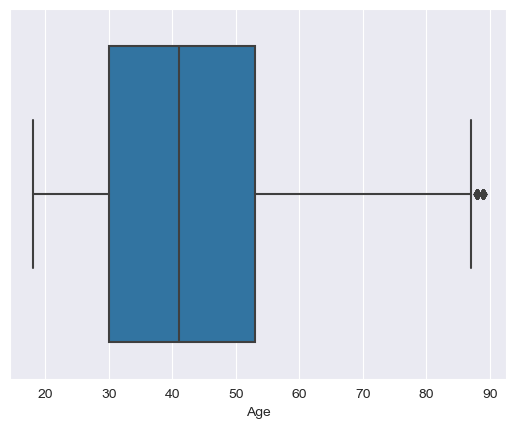

In [30]:
# draw box plot to check outliers for column "Age"
sns.set_style("darkgrid",{'axes.grid' : True})
sns.boxplot(x=df['Age'], orient='h')

In [31]:
Q1 = df['Age'].quantile(0.25)
Q3 = df['Age'].quantile(0.75)
IQR = Q3 - Q1
lower_thresh = Q1 - 1.5 * IQR
upper_thresh = Q3 + 1.5 * IQR
print(Q1, Q3, lower_thresh, upper_thresh)

30.0 53.0 -4.5 87.5


In [32]:
# check how many outliers in the column of "Age"
len(df[df['Age'] > 88])

46

According to the descriptive statistics, the minimum data in column "Age" is 18 and the maximum is 89, which the both minimum and maximum are fall into or nearly fall into the threshold (-4.5,87.5). It's reasonable to keep all values in the column 'Age' as is. Therefore, we decided that no outliers in column Age needs to be removed. 

<AxesSubplot:xlabel='Work_Experience'>

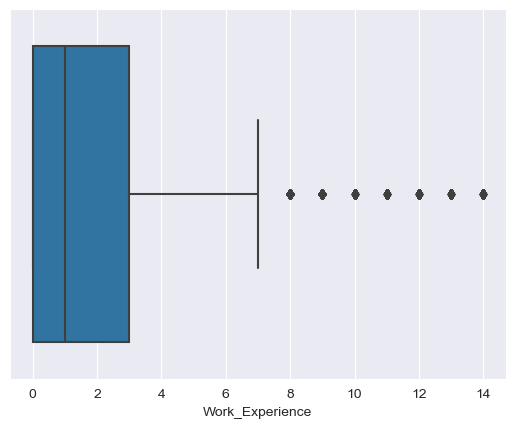

In [33]:
# draw box plot to check outliers for column "Work_Experience"
sns.set_style("darkgrid",{'axes.grid' : True})
sns.boxplot(x=df['Work_Experience'], orient='h')

In [34]:
Q1 = df['Work_Experience'].quantile(0.25)
Q3 = df['Work_Experience'].quantile(0.75)
IQR = Q3 - Q1
lower_thresh = Q1 - 1.5 * IQR
upper_thresh = Q3 + 1.5 * IQR
print(Q1, Q3, lower_thresh, upper_thresh)

0.0 3.0 -4.5 7.5


In [35]:
len(df[df['Work_Experience'] > 7.5])

1536

In [36]:
# check how many outliers in the column of "Work_Experience"
len(df[df['Work_Experience'] > 10])

247

In [37]:
# remove outliers in the column of "Work_Experience"
print("Data size before removing outliers in the column of Work_Experience:", df.shape)
df.drop(df[df['Work_Experience'] > 10].index, inplace=True)
print("Data size before removing outliers in the column of Work_Experience:", df.shape)

Data size before removing outliers in the column of Work_Experience: (10695, 10)
Data size before removing outliers in the column of Work_Experience: (10448, 10)


According to the descriptive statistics, the minimum data in column "Work_Experience" is 0 and the maximum is 14, which the minimum is fall into the threshold (-4.5,7.5) while the maximum doesn't fall into it. We can also tell from the boxplot above, there are many outliers above the threshould. If we set the threshold right to the upper_thresh=7.5, then 1536 outliers are too many to be removed for the scale of our dataset. So we think it's reasonable to set the threshold as 10 and remove all outliers with Work_Experience > 10 which include 247 outliers.

In [38]:
df.reset_index(inplace=True, drop=True)

<AxesSubplot:xlabel='Family_Size'>

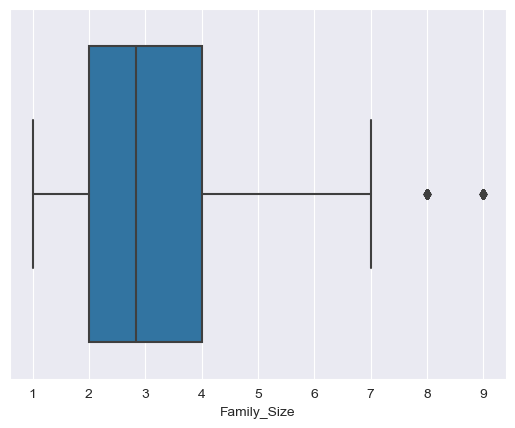

In [39]:
# draw box plot to check outliers for column "Family_Size"
sns.set_style("darkgrid",{'axes.grid' : True})
sns.boxplot(x=df['Family_Size'], orient='h')

In [40]:
Q1 = df['Family_Size'].quantile(0.25)
Q3 = df['Family_Size'].quantile(0.75)
IQR = Q3 - Q1
lower_thresh = Q1 - 1.5 * IQR
upper_thresh = Q3 + 1.5 * IQR
print(Q1, Q3, lower_thresh, upper_thresh)

2.0 4.0 -1.0 7.0


In [41]:
# check how many outliers in the column of "Family_Size"
len(df[df['Family_Size'] > 8])

56

According to the descriptive statistics, the minimum data in column "Family_Size" is 1 and the maximum is 9, which the both minimum and maximum are fall into or nearly fall into the threshold (-1.0,7.0). It's reasonable to keep all values in the column 'Age' as is. Therefore, no outliers in column Age needs to be removed.

#### Data transformation (normalize numerical data)

In [42]:
# normalize numerical attribute "Age"
nonnormalized_df = df[:]
scaler = MinMaxScaler(feature_range=(0,1))
df['Age'] = scaler.fit_transform(df[['Age']].values)

<AxesSubplot:xlabel='Age', ylabel='Count'>

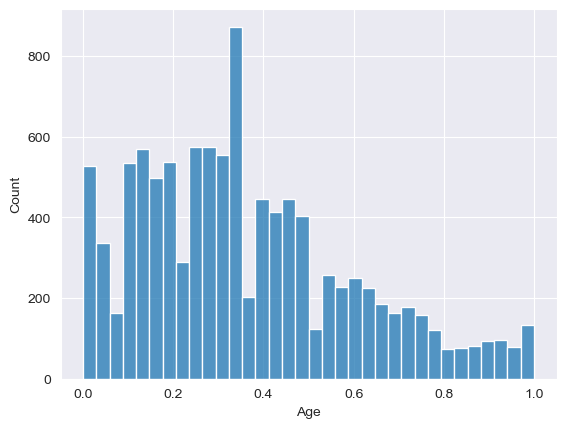

In [43]:
# check the distribution of the "Age" (after normalization)
sns.histplot(df['Age'])

In [44]:
# normalize numerical attribute "Work_Experience"
scaler = MinMaxScaler(feature_range=(0,1))
df['Work_Experience'] = scaler.fit_transform(df[['Work_Experience']].values)

<AxesSubplot:xlabel='Work_Experience', ylabel='Count'>

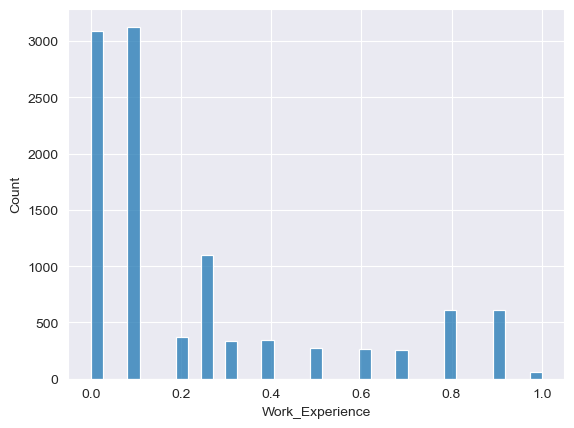

In [45]:
# check the distribution of the "Work_Experience" (after normalization)
sns.histplot(df['Work_Experience'])

In [46]:
# normalize numerical attribute "Family_Size"
scaler = MinMaxScaler(feature_range=(0,1))
df['Family_Size'] = scaler.fit_transform(df[['Family_Size']].values)

<AxesSubplot:xlabel='Family_Size', ylabel='Count'>

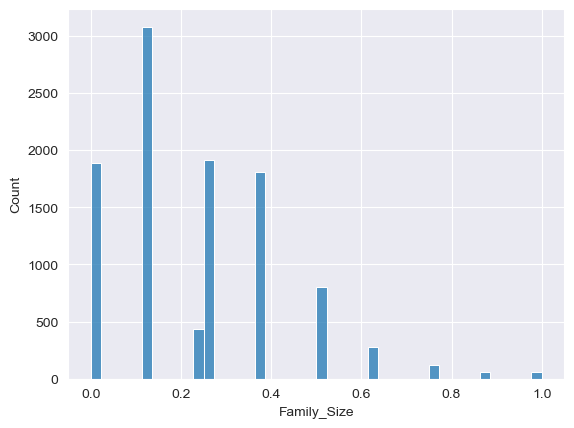

In [47]:
# check the distribution of the "Family_Size" (after normalization)
sns.histplot(df['Family_Size'])

In [48]:
df.describe()

,Age,Work_Experience,Family_Size
count,10448.000000,10448.000000,10448.000000
mean,0.361503,0.238606,0.231632
std,0.237297,0.285738,0.187318
min,0.000000,0.000000,0.000000
25%,0.169014,0.000000,0.125000
50%,0.323944,0.100000,0.230506
75%,0.492958,0.300000,0.375000
max,1.000000,1.000000,1.000000


#### Feature engineering
- Categorical data (encoding (one-hot/ordinal encoder))
- Numerical data (directly use the values)

In [49]:
# "Gender", "Ever_Married", "Graduated", "Profession", "Spending_Score", "Var_1"
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(df[['Gender']])

OneHotEncoder(handle_unknown='ignore')

In [50]:
# the categories learned during the fit process
ohe.categories_

[array(['Female', 'Male'], dtype=object)]

In [51]:
# encode the "Gender" with the learned categories during the fit process
ohe.transform(df[['Gender']]).toarray()[0]

array([0., 1.])

In [52]:
# convert the original "Gender" column to the encoded categories
df1=pd.DataFrame(ohe.transform(df[['Gender']]).toarray()).rename(columns={i: catg for i, catg in enumerate(ohe.categories_[0])})
df1

,Female,Male
0,0.0,1.0
1,1.0,0.0
2,1.0,0.0
3,0.0,1.0
4,1.0,0.0
...,...,...
10443,0.0,1.0
10444,1.0,0.0
10445,1.0,0.0
10446,0.0,1.0


In [53]:
# encoding the attribute "Ever_Married"
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(df[['Ever_Married']])
ohe.categories_

[array(['No', 'Yes'], dtype=object)]

In [54]:
ohe.transform(df[['Ever_Married']]).toarray()[0]

array([1., 0.])

In [55]:
# convert the original "Ever_Married" column to the encoded categories
df2=pd.DataFrame(ohe.transform(df[['Ever_Married']]).toarray()).rename(columns={0:"Not_Married", 1:"Married"})
df2

,Not_Married,Married
0,1.0,0.0
1,0.0,1.0
2,0.0,1.0
3,0.0,1.0
4,0.0,1.0
...,...,...
10443,1.0,0.0
10444,1.0,0.0
10445,1.0,0.0
10446,0.0,1.0


In [56]:
# encoding the attribute "Graduated"
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(df[['Graduated']])
ohe.categories_

[array(['No', 'Yes'], dtype=object)]

In [57]:
ohe.transform(df[['Graduated']]).toarray()

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [0., 1.],
       [0., 1.],
       [0., 1.]])

In [58]:
# convert the original "Graduated" column to the encoded categories
df3=pd.DataFrame(ohe.transform(df[['Graduated']]).toarray()).rename(columns={0:"Not_Grad", 1:"Grad"})
df3

,Not_Grad,Grad
0,1.0,0.0
1,0.0,1.0
2,0.0,1.0
3,0.0,1.0
4,0.0,1.0
...,...,...
10443,1.0,0.0
10444,0.0,1.0
10445,0.0,1.0
10446,0.0,1.0


In [59]:
# encoding the attribute "Profession"
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(df[['Profession']])
ohe.categories_

[array(['Artist', 'Doctor', 'Engineer', 'Entertainment', 'Executive',
        'Healthcare', 'Homemaker', 'Lawyer', 'Marketing'], dtype=object)]

In [60]:
# convert the original "Profession" column to the encoded categories
df4=pd.DataFrame(ohe.transform(df[['Profession']]).toarray()).rename(columns={5:"Healthcare", 2:"Engineer", 7:"Lawyer",3:"Entertainment", 4:"Executive", 1:"Doctor", 0:"Artist", 6:"Homemaker", 8:"Marketing"})
df4


,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
10443,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
10444,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10445,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
10446,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [61]:
# encoding the attribute "Spending_Score" using Ordinal Encoding instead
enc = OrdinalEncoder(categories=[['Low', 'Average', 'High']])
enc.fit(df[['Spending_Score']])
enc.categories_

[array(['Low', 'Average', 'High'], dtype=object)]

In [62]:
# convert the original "Spending_Score" column to the encoded categories
# pd.DataFrame(enc.transform(df[['Spending_Score']]).array()).rename(columns={i: catg for i, catg in enumerate(enc.categories_[0])})

df5=pd.DataFrame(enc.transform(df[['Spending_Score']])).rename(columns={0:"Spending_Score"})
df5

,Spending_Score
0,0.0
1,1.0
2,0.0
3,2.0
4,2.0
...,...
10443,0.0
10444,0.0
10445,0.0
10446,2.0


Since values for the attribute "Spending_Score" have orders, we want Low can be represented as 0, Average can be represented as 1, and High can be represented as 2. So here we are not using One Hot Encodding, but instead we chose to use Ordinal encoding. 

In [63]:
# encoding the attribute "Var_1"
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(df[['Var_1']])
ohe.categories_

[array(['Cat_1', 'Cat_2', 'Cat_3', 'Cat_4', 'Cat_5', 'Cat_6', 'Cat_7'],
       dtype=object)]

In [64]:
# convert the original "Var_1" column to the encoded categories
df6=pd.DataFrame(ohe.transform(df[['Var_1']]).toarray()).rename(columns={i: catg for i, catg in enumerate(ohe.categories_[0])})
df6


,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...
10443,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10444,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10445,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10446,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [65]:
# all categorical attributes except the target variable that we do not decide to encode
cat_col = ["Gender", "Ever_Married", "Graduated", "Profession", "Spending_Score", "Var_1"]

In [66]:
# check data types after label encoding
df.dtypes

Gender             category
Ever_Married       category
Age                 float64
Graduated          category
Profession         category
Work_Experience     float64
Spending_Score     category
Family_Size         float64
Var_1              category
Segmentation       category
dtype: object

In [67]:

merge_df = df1.merge(df2, left_index=True, right_index=True).merge(df['Age'], left_index=True, right_index=True).merge(df3, left_index=True, right_index=True).merge(df4, left_index=True, right_index=True).merge(df['Work_Experience'], left_index=True, right_index=True).merge(df5, left_index=True, right_index=True).merge(df['Family_Size'], left_index=True, right_index=True).merge(df6, left_index=True, right_index=True)


In [68]:
merge_df

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
0,0.0,1.0,1.0,0.0,0.056338,1.0,0.0,0.0,0.0,0.0,...,0.100000,0.0,0.375,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,1.0,0.0,0.0,1.0,0.281690,0.0,1.0,0.0,0.0,1.0,...,0.261978,1.0,0.250,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,1.0,0.690141,0.0,1.0,0.0,0.0,1.0,...,0.100000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,1.0,0.0,1.0,0.690141,0.0,1.0,0.0,0.0,0.0,...,0.000000,2.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,1.0,0.309859,0.0,1.0,0.0,0.0,0.0,...,0.261978,2.0,0.625,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10443,0.0,1.0,1.0,0.0,0.154930,1.0,0.0,0.0,0.0,0.0,...,0.900000,0.0,0.375,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10444,1.0,0.0,1.0,0.0,0.239437,0.0,1.0,0.0,1.0,0.0,...,0.100000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10445,1.0,0.0,1.0,0.0,0.492958,0.0,1.0,0.0,0.0,0.0,...,0.261978,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10446,0.0,1.0,0.0,1.0,0.408451,0.0,1.0,0.0,0.0,0.0,...,0.100000,2.0,0.500,0.0,0.0,0.0,1.0,0.0,0.0,0.0


For numerical data, we can just directly use the values

##### Additional Exploratory Data Analysis

In [69]:
nonnormalized_df

,Gender,Ever_Married,Age,Graduated,Profession,Work_Experience,Spending_Score,Family_Size,Var_1,Segmentation
0,Male,No,22,No,Healthcare,1.000000,Low,4.0,Cat_4,D
1,Female,Yes,38,Yes,Engineer,2.619777,Average,3.0,Cat_4,A
2,Female,Yes,67,Yes,Engineer,1.000000,Low,1.0,Cat_6,B
3,Male,Yes,67,Yes,Lawyer,0.000000,High,2.0,Cat_6,B
4,Female,Yes,40,Yes,Entertainment,2.619777,High,6.0,Cat_6,A
...,...,...,...,...,...,...,...,...,...,...
10443,Male,No,29,No,Healthcare,9.000000,Low,4.0,Cat_6,B
10444,Female,No,35,Yes,Doctor,1.000000,Low,1.0,Cat_6,A
10445,Female,No,53,Yes,Entertainment,2.619777,Low,2.0,Cat_6,C
10446,Male,Yes,47,Yes,Executive,1.000000,High,5.0,Cat_4,C


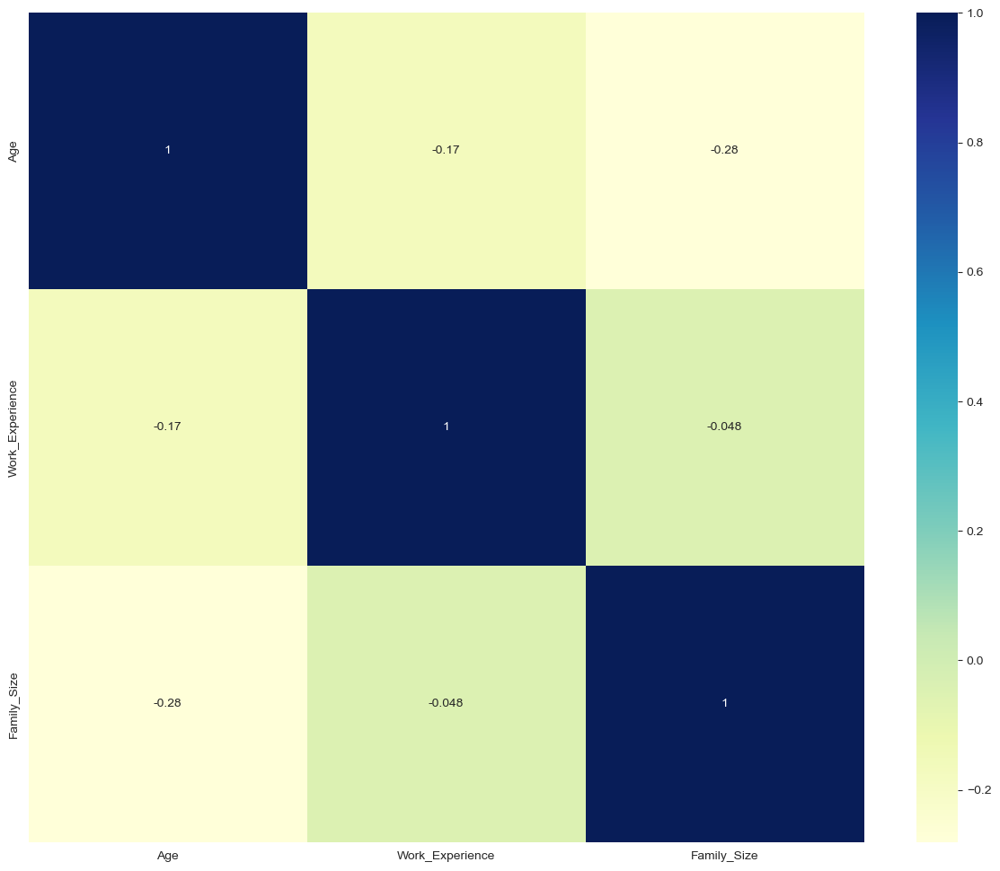

In [70]:
# plot a heatmap for all numerical variables 'Age', 'Work_Experience', and 'Family_Size'

plt.figure(figsize=(15,12))
sns.heatmap(df.corr(), annot=True, cmap='YlGnBu');

In [71]:
np.corrcoef(nonnormalized_df['Family_Size'], nonnormalized_df['Work_Experience'])

array([[ 1.        , -0.04783651],
       [-0.04783651,  1.        ]])

According to the heatmap above, 'Work_Experience' and 'Family_Size' aren't strongly correlated. However, 'Age' and 'Family_Size' are correlated with a correlation of -0.28, which means older customers in our dataset may refer to a smaller family size. 

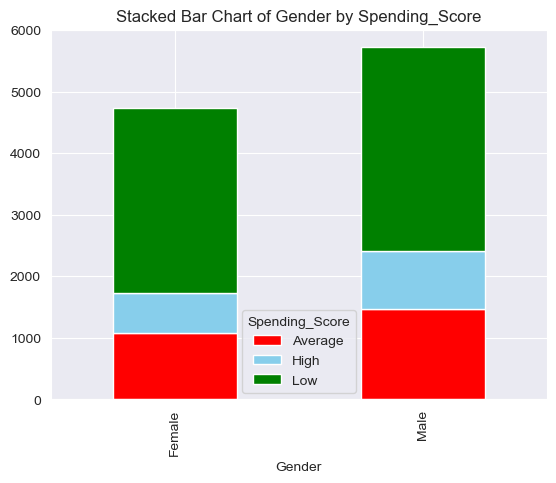

In [72]:
# create stacked bar chart for Gender vs. Spending_Score

customers = nonnormalized_df.groupby(['Gender', 'Spending_Score']).size().reset_index(name='counts')

customers.pivot(index='Gender', columns='Spending_Score', values='counts').plot(kind='bar', stacked=True, color=['red', 'skyblue', 'green'])
plt.title("Stacked Bar Chart of Gender by Spending_Score")
plt.show()

In [73]:
# the distribution
total_male = nonnormalized_df[nonnormalized_df['Gender'] == 'Male'].shape[0]
total_female = nonnormalized_df[nonnormalized_df['Gender'] == 'Female'].shape[0]
i=customers[customers['Gender'] == 'Male']['counts'] / total_male
s=customers[customers['Gender'] == 'Female']['counts'] / total_female
v = pd.concat([s, i], axis=0)
customers.merge(v, left_index=True, right_index=True)

,Gender,Spending_Score,counts_x,counts_y
0,Female,Average,1086,0.229501
1,Female,High,642,0.135672
2,Female,Low,3004,0.634827
3,Male,Average,1469,0.256998
4,Male,High,934,0.163401
5,Male,Low,3313,0.579601


From the stacked bar chart above, it's obvious to tell that there are more male customers than female customers in our dataset. Additionally, compared to male customers, female custmers have a higher rate with the spending_score of low and lower rate with spending_score of avearge and high, which potentially tells the story that male customers probably earn more than female customers which they have more money to spend or male customers have more control over their money than female customers so they can decide how much to spend. 

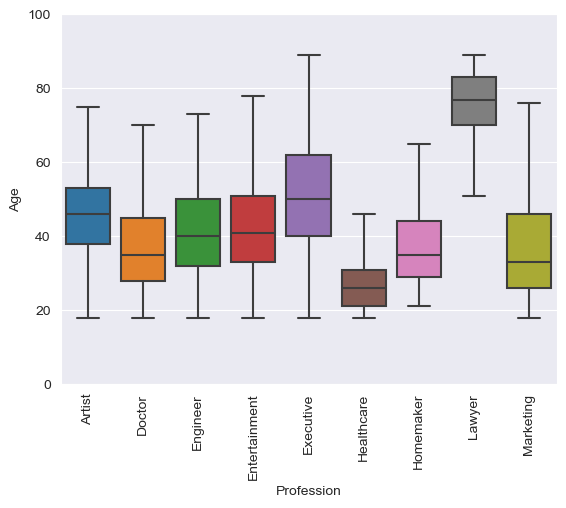

In [74]:
# make a box plot to see the relationship between Age and different professions

ax = sns.boxplot(x='Profession', y='Age', data=nonnormalized_df, fliersize=0)
ax.set_ylim([0, 100]);
ax.tick_params(axis='x', rotation=90)

From the box plot above, we found that customers who are lawyer have the highest age compared to other professions. Customers who work in the healthcare field have the lowest age. We can also see from the heatmap below, these two professions are correlated with Age. However, for the rest of professions, the correlations between the professions and Age aren't strongly correlated. 

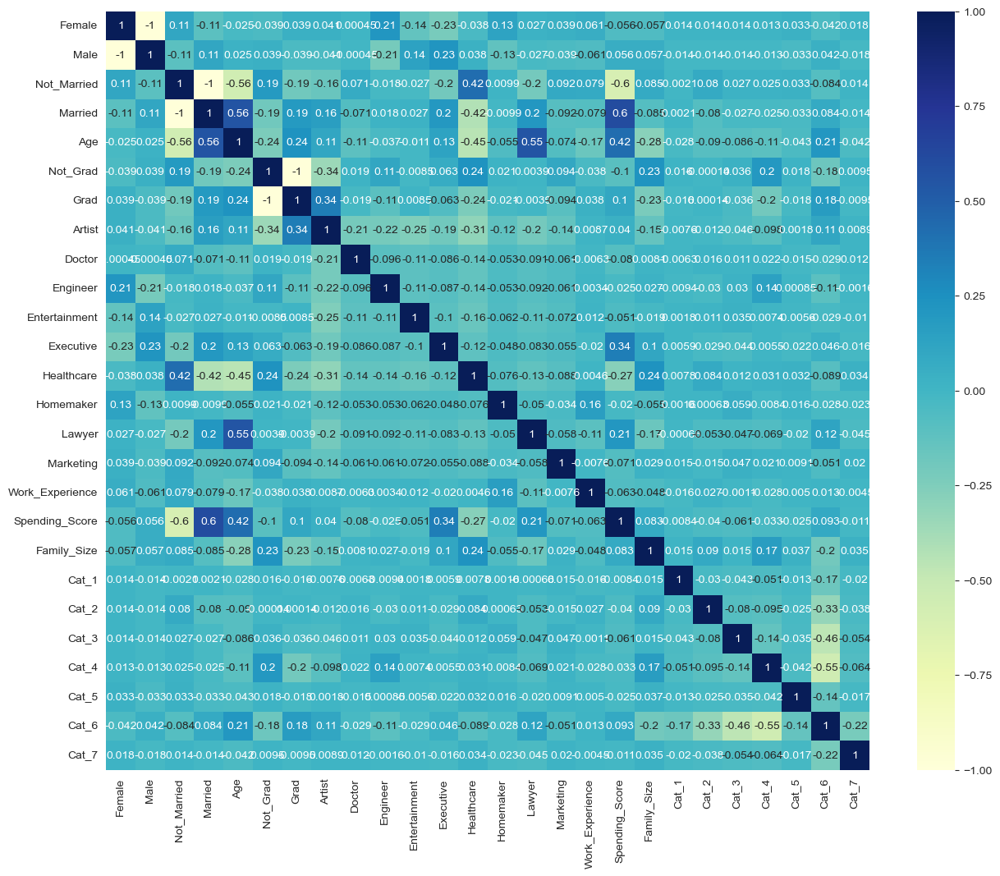

In [75]:
plt.figure(figsize=(15,12))
sns.heatmap(merge_df.corr(), annot=True, cmap='YlGnBu');

According to the heatmap above, Age and Spending_Score is strongly correlated with a correlation of 0.42, Grad and Artist are the two variables which are correlated with a correlation of 0.34. In addition, Family_Size and Healthcare are also correlated with a correlation of 0.24.

### Train machine learning models
After we finish doing text preprocessing including data cleaning, data transformation, and feature engineering, our next step is to build machine learning models based on our cleaned data and decide which model to use. The followings are the models we plan to use:

- Decision Tree
- Random Forest
- Linear Model for multi-classification

##### Resampling the train and test data

In [76]:
# Get the input matrix and target array
X,y = merge_df, df['Segmentation']
X.shape, y.shape

((10448, 26), (10448,))

In [77]:
#Resample 80% Train and 20% Test 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((8358, 26), (2090, 26), (8358,), (2090,))

##### Train Decision Tree model for classification

In [78]:
# Create a DecisionTreeClassifier object
DT_clf = DecisionTreeClassifier(criterion='entropy', random_state=42)

In [79]:
# Use the "fit" function of the DecisionTreeClassifier object on the "train" portion of the input matrix
DT_clf.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', random_state=42)

In [80]:
# Plot the fitted DecisionTreeClassifier
dot_data = tree.export_graphviz(DT_clf, out_file=None) 
graph = graphviz.Source(dot_data)  
graph

In [81]:
dot_data = tree.export_graphviz(DT_clf, out_file=None, 
                                feature_names=list(merge_df.columns),  
                                class_names=np.array(df['Segmentation'].unique()),  
                                filled=True, rounded=True,  
                                special_characters=True)  
graph = graphviz.Source(dot_data)  
graph

From this decision tree graph, we found that this model mostly uses these features frequently such as 'Age', 'Spending_Score', 'Family_Size', 'Artist', 'Healthcare', and 'Marketing' to be the criterian to generate the leaves. With these criterions, the decision tree classifier tends to have more ways (more leaves) to classify class C than D, A, B.
It is proven in the later histogram of seg_not_pred that class C is predicted more accurately than the rest of classes. A lot of Class A and B fail to be predicted due to the lack of leaves(outputs) in our decision tree model. Although class D also has not many leaves, it is the majority group in both our resampled training and testing data which may allows the model to have a higher accuracy rate for it.

#### Evaluate Decision Tree model for classification
- GridSearchCV
- Manually modify parameters

###### Model Evaluation by using GridSearchCV

In [82]:
accuracy=DT_clf.score(X_test, y_test)
round(accuracy, 3)

0.394

In [83]:
# use GridSearchCV to modify the parameters to improve the DT model performance
parameters = {'criterion':('gini', 'entropy', 'log_loss'),
              'splitter':('best', 'random'), 
              'min_samples_split':[2, 4, 6, 8],
             'min_samples_leaf':[1, 3, 5, 7],
             'max_features':('sqrt', 'log2', None),
             'min_impurity_decrease':[0.0, 0.1, 0.2, 0.3]}

DT_clf_2 = DecisionTreeClassifier()
clf = GridSearchCV(DT_clf_2, parameters)
clf.fit(X_train, y_train)
GridSearchCV(estimator=DecisionTreeClassifier(),
             param_grid=parameters, cv=5)


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ('gini', 'entropy', 'log_loss'),
                         'max_features': ('sqrt', 'log2', None),
                         'min_impurity_decrease': [0.0, 0.1, 0.2, 0.3],
                         'min_samples_leaf': [1, 3, 5, 7],
                         'min_samples_split': [2, 4, 6, 8],
                         'splitter': ('best', 'random')})

In [84]:
# Parameters originally used but it takes so long to run this
# parameters = {'criterion':('gini', 'entropy', 'log_loss'),
#               'splitter':('best', 'random'), 
#               'max_depth':[None, 2, 4, 6],
#               'min_samples_split':[2, 4, 6, 8],
#              'min_samples_leaf':[1, 3, 5, 7],
#              'max_features':('sqrt', 'log2', None),
#               'max_leaf_nodes':[None, 5, 10, 15],
#              'min_impurity_decrease':[0.0, 0.1, 0.2, 0.3]}

In [85]:
clf.best_params_

{'criterion': 'entropy',
 'max_features': 'sqrt',
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 5,
 'min_samples_split': 6,
 'splitter': 'random'}

In [86]:
DT_clf = DecisionTreeClassifier(criterion='log_loss', 
                                splitter='best', 
                                min_samples_split=6,
                                min_samples_leaf=7,
                                max_features='sqrt', 
                                random_state=42,
                                min_impurity_decrease=0.0)

In [87]:
DT_clf.fit(X_train, y_train)

DecisionTreeClassifier(criterion='log_loss', max_features='sqrt',
                       min_samples_leaf=7, min_samples_split=6,
                       random_state=42)

In [88]:
accuracy=DT_clf.score(X_test, y_test)
round(accuracy, 3)

0.433

By using GridSearchCV and modifying the parameters based on GridSearchCV's suggestions, the model performance is able to increase from 0.394 to 0.446. The accuracy of this decision tree classifier model is still not very good. We think GridSearchCV is still limited to be used to improve the model performance, so we decide to manually modify the parameters and to see how the model performance goes by modifying the value for each parameter one by one. Another disadvantage of GridSearchCV we found is that if we put too many parameters into it, it takes a very long time to process and run it. So to make it works, we have to not put some parameters in it and do it manually. 

In [89]:
# manually modify the parameters
DT_clf = DecisionTreeClassifier(criterion='entropy',
                                splitter='best',
                                max_depth=4,
                                min_samples_split=2,
                                min_samples_leaf=1,
                                min_weight_fraction_leaf=0.0,
                                max_features=None,
                                random_state=24,
                               max_leaf_nodes=13,
                               min_impurity_decrease=0.0,
                                class_weight=None,
                               ccp_alpha=0.0)

In [90]:
DT_clf.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=4, max_leaf_nodes=13,
                       random_state=24)

In [91]:
accuracy=DT_clf.score(X_test, y_test)
round(accuracy, 3)

0.476

By manually check all possible parameters in DecisionTreeClassifier, we found criterion 'entropy' or 'log_loss' is better than the default criterion 'gini', splitter 'best' is better than 'random'. With higher max_depth, the model performance becomes worse so we chose 4 which gives us the best accuracy of prediction. With max_depth set to 4, numbers set for min_samples_split don't change the model performance that much so we just set the default number 2. For the parameter 'min_samples_leaf', we found with larger number set for the parameter, the worse the model performance will be so we set the default value of 1 to this parameter. Similar to 'min_samples_leaf', 'min_weight_fraction_leaf' is also the parameter we found where with larger number set to it the model performance gets worse so we just set the lowest number 0 to the parameter. For the parameter 'max_features, we foudnd 'log2' is the worst, 'auto' and 'sqrt' give the same model performance, and 'None' makes the model perform the best. We tried different numbers for the parameter 'random_state' and figured out set it to 24 gives the medel the best performance. For the parameter 'max_leaf_nodes', we found numbers over 13 set for the parameter can all give the model the best performance. For 'min_impurity_decrease', we found with higher number set for the parameter, the model performance gets worse so we just set it to 0. Same as 'ccp_alpha', with larger ccp_alpha, the model performance gets worse. Lastly, for the parameter 'class_weight', set it to None and 'balanced' gives the same model performance. Compared to what we did using GridSearchCV and what we did manually, the model performance improves from 0.433 to 0.476. Therefore, we think that doing it manuall can give us more flexibility to adjust all the parameters without waiting for too long to run the code. 

##### Result and Error Analysis

In [92]:
# check if our target variable 'Segmentation' is balanced or not 
# check if there are any imbalanced groups in our training data after resampling that leads to the inaccurary
y_train.value_counts()

D    2354
A    2128
C    1963
B    1913
Name: Segmentation, dtype: int64

In [93]:
y_test.value_counts()

A    599
D    599
B    446
C    446
Name: Segmentation, dtype: int64

In our training data, we calculated that D is around 28.2% of the whole 8358 data, A is around 25.5% of the whole dataset, C is 23.5% of the whole data, and B is 22.9% of the whole data. After sythesizing the original train and test data set. Compared to our original training data, the distribution of each category is similar. Although the training data is not perfectly 25% for each categories, the current distribution is roughly close to 25%. For our resampled testing data, A is around 28.7% of the whole 2090 data, D is also 28.7% of the whole 2090 data, B and C are each 21.3% of the whole data. The 4 categories in the resampled testing data are not perfectly balanced but they are much balanced than the original test dataset before concatenating and resampling. 

In [94]:
X_test

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
5426,1.0,0.0,0.0,1.0,0.140845,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
673,1.0,0.0,1.0,0.0,0.169014,0.0,1.0,0.0,0.0,0.0,...,0.1,0.0,0.625,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5228,1.0,0.0,0.0,1.0,0.380282,1.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.750,0.0,0.0,0.0,0.0,0.0,0.0,1.0
5945,1.0,0.0,0.0,1.0,0.478873,0.0,1.0,1.0,0.0,0.0,...,0.3,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1217,0.0,1.0,1.0,0.0,0.450704,1.0,0.0,0.0,1.0,0.0,...,0.9,0.0,0.250,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
611,0.0,1.0,1.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.625,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10012,0.0,1.0,0.0,1.0,0.915493,0.0,1.0,0.0,0.0,0.0,...,0.1,0.0,0.125,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4513,1.0,0.0,0.0,1.0,0.281690,1.0,0.0,0.0,0.0,1.0,...,0.1,0.0,0.000,0.0,0.0,0.0,1.0,0.0,0.0,0.0
511,1.0,0.0,1.0,0.0,0.211268,0.0,1.0,0.0,0.0,0.0,...,0.8,0.0,0.000,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [95]:
# find all features in the decision tree 

DT_clf.feature_names_in_

array(['Female', 'Male', 'Not_Married', 'Married', 'Age', 'Not_Grad',
       'Grad', 'Artist', 'Doctor', 'Engineer', 'Entertainment',
       'Executive', 'Healthcare', 'Homemaker', 'Lawyer', 'Marketing',
       'Work_Experience', 'Spending_Score', 'Family_Size', 'Cat_1',
       'Cat_2', 'Cat_3', 'Cat_4', 'Cat_5', 'Cat_6', 'Cat_7'], dtype=object)

In [96]:
# find top 7 coefficient features
importances = DT_clf.feature_importances_
results_dt = pd.DataFrame({'feature': list(range(X.shape[1])), 'importance': importances})
results_dt = results_dt.sort_values('importance', ascending = False)
print(results_dt.head(10))

    feature  importance
4         4    0.590895
17       17    0.160835
7         7    0.156377
12       12    0.030913
6         6    0.026427
15       15    0.012859
18       18    0.011714
22       22    0.009980
0         0    0.000000
24       24    0.000000


Among all 26 features, we found the top 7 coefficient features are 'Age', 'Spending_Score', 'Artist', 'Healthcare', 'Grad', 'Marketing', 'Family_Size'. These are the top 7 important features that are computed as the (normalized) total reduction of the criterion brought by that feature and are the top 7 most helpful features in the decision tree classifier to help make the decisions on which segmentation each individual customer belongs to. 

In [97]:
# find all wrong predictions and show examples where the model fails
wrong_pred = []
seg_not_pred = []
wrong_list = []
predictions = DT_clf.predict(X_test)
for index , prediction, label in zip(X_test.index, predictions, y_test):
    if prediction != label:
        wrong_pred.append(prediction)
        seg_not_pred.append(label)
        wrong_list.append([prediction, label])
        print('Customer', index, 'has been classified as ', prediction, 'and should be ', label)

Customer 5228 has been classified as  B and should be  A
Customer 1217 has been classified as  A and should be  D
Customer 9786 has been classified as  D and should be  A
Customer 1851 has been classified as  C and should be  B
Customer 6187 has been classified as  A and should be  B
Customer 8405 has been classified as  D and should be  B
Customer 6328 has been classified as  C and should be  A
Customer 2252 has been classified as  D and should be  C
Customer 7586 has been classified as  C and should be  B
Customer 4572 has been classified as  A and should be  D
Customer 8040 has been classified as  D and should be  B
Customer 3166 has been classified as  D and should be  B
Customer 5169 has been classified as  C and should be  A
Customer 1022 has been classified as  A and should be  B
Customer 9885 has been classified as  D and should be  C
Customer 3794 has been classified as  A and should be  D
Customer 900 has been classified as  C and should be  B
Customer 7709 has been classifie

In [98]:
# check the number of wrong predictions
len(wrong_pred)

1095

The number of 1095 corresponds to our calculation of model performance using score(). According to the accuracy of this Desicision Tree model 47.6%, the percentage of the wrong predictions should be 55.4%. Multiple the total number of our test sample 2090 by 52.4%, we get the exact same number of 1095. 

In [99]:
A_wrong_list = []
B_wrong_list = []
for i in wrong_list:
    if i[1]=='A':
        A_wrong_list.append(i)
    if i[1]=='B':
        B_wrong_list.append(i)

A_df = pd.DataFrame(A_wrong_list)
B_df = pd.DataFrame(B_wrong_list)
A_df

,0,1
0,B,A
1,D,A
2,C,A
3,C,A
4,B,A
...,...,...
329,D,A
330,C,A
331,B,A
332,B,A


<AxesSubplot:ylabel='Count'>

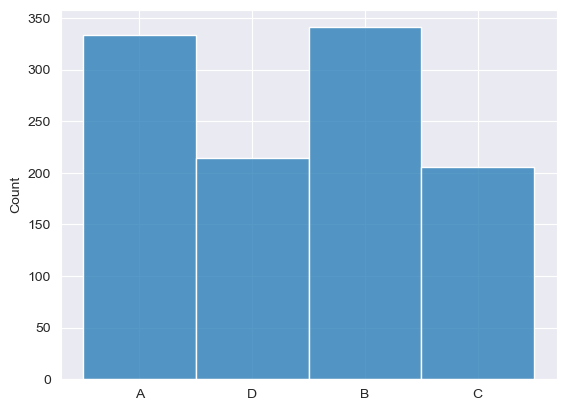

In [100]:
# explain where do you think the errors come from and why
sns.histplot(seg_not_pred)


From the histogram above, we can see that the top 2 segmentations which are not predicted correct by the model are segmentation A and B. It makes sense that B is the category that couldn't be predicted correct the most since B either in our resampled training data or the resampled testing data is the minority group. The model may not have enough data about B to learn the patterns and relationships which leads to the poor model prediction on B. However, from the aspect of inbalance data, we can't explain why there are also a lot of A which are predicted correctly by the model since A is neither a minority group nor majority group compared to segmentation D. We decided to deep dive into the segmentation A and B to see what are the most wrong segmentation predicted for A and B. 

<AxesSubplot:xlabel='0', ylabel='Count'>

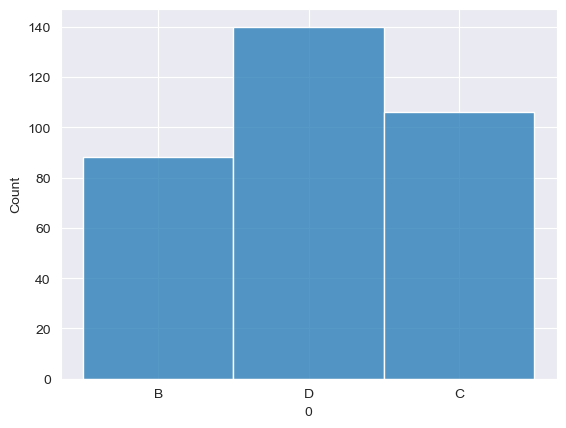

In [101]:
sns.histplot(A_df[0])

Most wrong predictions for category A is D. D is the majority group in both resampled training and testing dataset, so it's expected that the model will have a bias of making classification of D. Also, according to the DT visualization graph, there are more leaves that make the classification of the category of C and the decisions are predominantly made by the attributes 'Family_Size' and 'Work_Experience', and 'Age'. From our Exploratory data analysis section above, although it doesn't seem 'Family_Size' and 'Work_Experience' are strongly correlated, there's a negative correlation between 'Family_Size' and 'Age'. The correlations between these two features may lead to collinearity that overestimated the category C in our case, which explains why the category of A is predominantly predicted wrong as the category of D and C. 

<AxesSubplot:xlabel='0', ylabel='Count'>

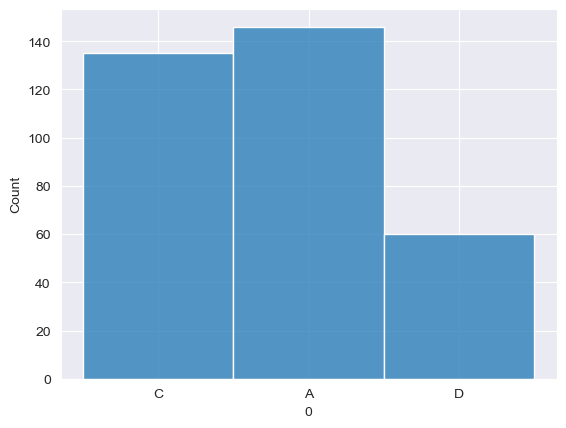

In [102]:
sns.histplot(B_df[0])

Most wrong predictions for category B is C and A. Following with the explaination on the possible overestimation of the category of C above, the model may over-rely on the one of the two features 'Family_Size' and 'Age' to make predictions, leading to an overestimation of the importance of these two features, which we can also see from the top 7 coefficient features where the two features 'Family_Size' and 'Age' are in. In this case of how the category of B is predicted incorrectly, in addition to the catogory of C, A is the other wrong predictions for B. In general, B is the minority group in both training and testing groups while D is the majority group so it's easy for the model to make correct predictions on D but may mistakenenly put customers from the category of B in the wrong categories of A and C. 

Possible solutions to improve the model performance:
- Address the imbalance categories: First, we can resample our dataset again to make it more balance for both training and testing dataset by oversampling the minority group of the category of B and C to make each of the four categories in both training and testing dataset rougly 25% of all samples. The reason we may not want to use undersampling because our dataset is not a very large dataset so by undersampling for the majority group, the model performance might also be affected by the lack of enough data to train the model. 
- reselect features and revise the quality of the features used to split the tree: for example, with larger correlations between features, the model performance will be negatively affected by the collinearity considering that the collinearity will make the model overfit with these strongly correlated features, which may lead to the overestimation of certain categories in our target variable. 

### Random Forest Classifier

In [103]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

Start from a simple model with default parameters

In [104]:
rf = RandomForestClassifier(oob_score=True, random_state=0)
rf.fit(X_train,y_train)

RandomForestClassifier(oob_score=True, random_state=0)

Test the accuracy of the initial simple model

In [105]:
test_predict = rf.predict(X_test)
accuracy_score(y_test, test_predict)

0.4196172248803828

##### Use GridSearchCV to modify the parameters to improve the RF model performance

Modify parameter 1: n_estimators

In [106]:
param = {"n_estimators": range(1,101)}
gs = GridSearchCV(estimator=rf, param_grid=param)
gs.fit(X_train, y_train)

/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensem

/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensem

/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/Users/wangzijie/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensem

GridSearchCV(estimator=RandomForestClassifier(oob_score=True, random_state=0),
             param_grid={'n_estimators': range(1, 101)})

In [107]:
gs.best_params_

{'n_estimators': 86}

In [108]:
gs.best_score_

0.4235448360578286

When the n_estimators takes 86, that is, the number of sub-decision trees of random forest is 86, the accuracy of random forest is the highest.

Modify parameter 2: max_features

In [109]:
rf1 = RandomForestClassifier(n_estimators=86, oob_score=True, random_state=0)
rf1.fit(X_train,y_train)

RandomForestClassifier(n_estimators=86, oob_score=True, random_state=0)

In [110]:
param = {"max_features": range(1,27,1)}
gs = GridSearchCV(estimator=rf1, param_grid=param)

In [111]:
gs.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(n_estimators=86, oob_score=True,
                                              random_state=0),
             param_grid={'max_features': range(1, 27)})

In [112]:
gs.best_params_

{'max_features': 11}

In [113]:
gs.best_score_

0.4273746631962639

When the max_feature takes 11, that is, the number of features to consider when looking for the best split is 11, the accuracy of random forest is the highest. 

Modify parameter 3: max_depth

In [114]:
rf2 = RandomForestClassifier(n_estimators=86, max_features=11, oob_score=True, random_state=0)

In [115]:
param = {"max_depth": range(1,30,1)}
gs = GridSearchCV(estimator=rf2, param_grid=param)

In [116]:
gs.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(max_features=11, n_estimators=86,
                                              oob_score=True, random_state=0),
             param_grid={'max_depth': range(1, 30)})

In [117]:
gs.best_params_

{'max_depth': 7}

In [118]:
gs.best_score_

0.48516452916197783

When the maximum depth of the tree is 7, the accuracy of random forest is the highest.

Modify parameter 4: min_samples_leaf

In [119]:
rf3 = RandomForestClassifier(n_estimators=86, max_features=11, max_depth=7, 
                             oob_score=True, random_state=0)

In [120]:
param = {"min_samples_leaf": range(1,50,1)}
gs = GridSearchCV(estimator=rf3, param_grid=param)

In [121]:
gs.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(max_depth=7, max_features=11,
                                              n_estimators=86, oob_score=True,
                                              random_state=0),
             param_grid={'min_samples_leaf': range(1, 50)})

In [122]:
gs.best_params_

{'min_samples_leaf': 16}

In [123]:
gs.best_score_

0.48707897743379175

When the minimum number of samples required to be at a leaf node is 16, the accuracy of random forest is the highest.

Modify parameter 5: criterion

In [124]:
rf4 = RandomForestClassifier(n_estimators=86, max_features=11, max_depth=7, 
                             min_samples_leaf=16, oob_score=True, random_state=0)

In [125]:
param = {'criterion':['gini', 'entropy']}
gs = GridSearchCV(estimator=rf4, param_grid=param)

In [126]:
gs.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(max_depth=7, max_features=11,
                                              min_samples_leaf=16,
                                              n_estimators=86, oob_score=True,
                                              random_state=0),
             param_grid={'criterion': ['gini', 'entropy']})

In [127]:
gs.best_params_

{'criterion': 'gini'}

When the criterion is gini as default, the accuracy of random forest is the highest, so modifying criterion won't improve the model performance.

Modify parameter 6: min_samples_split

In [128]:
param = {"min_samples_split": np.arange(2, 2+20, 1)}
gs = GridSearchCV(estimator=rf4, param_grid=param)

In [129]:
gs.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(max_depth=7, max_features=11,
                                              min_samples_leaf=16,
                                              n_estimators=86, oob_score=True,
                                              random_state=0),
             param_grid={'min_samples_split': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19, 20, 21])})

In [130]:
gs.best_params_

{'min_samples_split': 2}

When the minimum number of samples required to split an internal node is 2 as default, the accuracy of random forest is the highest, so modifying criterion won't improve the model performance.

In [131]:
# fit the last modified model on training data
rf4.fit(X_test,y_test)

RandomForestClassifier(max_depth=7, max_features=11, min_samples_leaf=16,
                       n_estimators=86, oob_score=True, random_state=0)

##### Visualize an individual tree of the random forest

As number of trees in a random forest is defined by the n_estimators parameter, we have 86 trees in the modified RandomForestClassifier (rf4). Here we visualize an individual tree to get a general picture of the forest classification.

In [132]:
# Encode target names (segments) with label encoder
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train_labels = le.fit_transform(y_train)
y_test_labels = le.fit_transform(y_test)

In [133]:
# Fit on training data
rf4.fit(X_train,y_train_labels)

RandomForestClassifier(max_depth=7, max_features=11, min_samples_leaf=16,
                       n_estimators=86, oob_score=True, random_state=0)

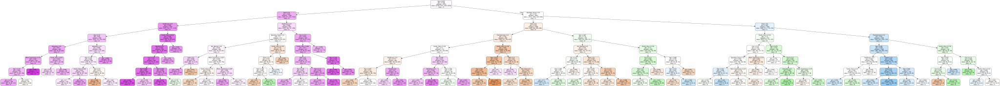

In [134]:
dot_data = tree.export_graphviz(rf4.estimators_[0], out_file=None, 
                                feature_names=list(merge_df.columns),  
                                class_names=le.classes_,  
                                filled=True, rounded=True,  
                                special_characters=True)  
graph = graphviz.Source(dot_data)  
graph 

#### Result analysis of RandomForestClassifier

In the result analysis part, we first check the accurary of the RandomForestClassifier model predition, and then join the true and predicted segmentation together to identify the misclassified samples. Lastly, we check and visualize the feature importance.

In [135]:
# accuracy of class prediction on train data
rf4.fit(X_train, y_train_labels)
accuracy=rf4.score(X_train, y_train_labels)
round(accuracy, 3)

0.513

In [136]:
# accuracy of class prediction on test data
accuracy=rf4.score(X_test, y_test_labels)
round(accuracy, 3)

0.487

The accurary score of the random forest classifier is 0.487, a little higher than the decision tree classifier.

Join the true and predicted segmentation together to identify the error

In [137]:
test_predict_labels = rf4.predict(X_test)
print(test_predict_labels)

[0 3 0 ... 0 3 3]


In [138]:
# convert the prediction result of test back to Segment letters
test_predict = le.inverse_transform(test_predict_labels)
print(test_predict)

['A' 'D' 'A' ... 'A' 'D' 'D']


In [139]:
# convert array (test_predict) and series (y_test) to dataframe
y_test_predict = pd.DataFrame(test_predict)
y_test_predict.columns = ['Segmentation_predict']

y_test_true = pd.DataFrame(y_test).reset_index(drop=True)

In [140]:
# join dataframes and identify where the classifier make wrong predictions
df = pd.concat([y_test_true, y_test_predict], axis=1)
df['result'] = np.where(df['Segmentation']==df['Segmentation_predict'],'same','different')
df.index = y_test.index
print(df)

      Segmentation Segmentation_predict     result
5426             A                    A       same
673              D                    D       same
5228             A                    A       same
5945             B                    C  different
1217             D                    A  different
...            ...                  ...        ...
611              D                    D       same
10012            A                    A       same
4513             A                    A       same
511              A                    D  different
4789             B                    D  different

[2090 rows x 3 columns]


In [141]:
# the total number of misclassified test samples
sum(df['result']=='different')

1073

In [142]:
# check the portion of each features in misclassified samples
mistakes_index = df[df.result=='different'].index
for i in X_test.columns:
    print(i, round(X_test.loc[mistakes_index, i].mean()*X_test.loc[mistakes_index].shape[0] / (X_test.loc[:, i].mean()*X_test.shape[0]), 3))

Female 0.537
Male 0.492
Not_Married 0.471
Married 0.543
Age 0.543
Not_Grad 0.465
Grad 0.543
Artist 0.547
Doctor 0.594
Engineer 0.542
Entertainment 0.537
Executive 0.518
Healthcare 0.325
Homemaker 0.625
Lawyer 0.588
Marketing 0.514
Work_Experience 0.527
Spending_Score 0.551
Family_Size 0.49
Cat_1 0.595
Cat_2 0.556
Cat_3 0.472
Cat_4 0.479
Cat_5 0.435
Cat_6 0.524
Cat_7 0.492


It shows that most features have similar error level, while the Homemaker feature has a litter higher contribution in misclassifying and Healthcare feature has a litter lower level. It means that Healthcare feature is more helpful in correctly classifying, while Homemaker feature makes the prediction less accurate. This result suggests that we can improve the model prediction by collecting more accurate occupation data.

##### Visualize the feature importance

In [143]:
rf4.fit(X_train, y_train)

RandomForestClassifier(max_depth=7, max_features=11, min_samples_leaf=16,
                       n_estimators=86, oob_score=True, random_state=0)

In [144]:
y_importances = rf4.feature_importances_
x_importances = merge_df.columns
y_pos = np.arange(len(x_importances))

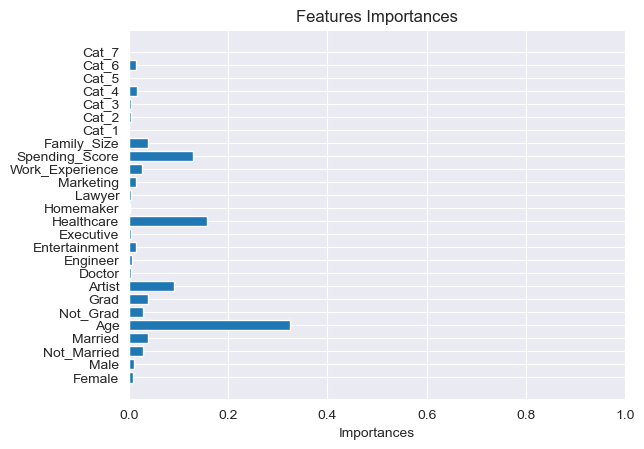

In [145]:
plt.barh(y_pos, y_importances, align='center')
plt.yticks(y_pos, x_importances)
plt.xlabel('Importances')
plt.xlim(0,1)
plt.title('Features Importances')
plt.show()

The feature weight plot shows that Age is the most important feature in classification, the next important features are Healthcare and Spending score.

### Train a linear model (logistic regression model) for classification

In [146]:
from sklearn.linear_model import LogisticRegression

In [147]:
# class distribution
Counter(y_train)

Counter({'B': 1913, 'D': 2354, 'C': 1963, 'A': 2128})

In [148]:
log_clf = LogisticRegression(random_state=0, max_iter=1000).fit(X_train, y_train)

In [149]:
# maximum number of iterations taken to converge
log_clf.n_iter_

array([111], dtype=int32)

In [150]:
# the mean accuracy on the training data
log_clf.score(X_train, y_train)

0.4688920794448433

In [151]:
# the mean accuracy on the test data
log_clf.score(X_test, y_test)

0.4473684210526316

In [152]:
# check the prediected class label for the first 10 training samples
log_clf.predict(X_train[:10])

array(['B', 'A', 'D', 'C', 'C', 'A', 'C', 'D', 'D', 'C'], dtype=object)

In [153]:
# compare to the ground truth
y_train[:10]

2922     B
6647     B
2522     D
8400     C
5239     A
8744     D
6537     B
10125    D
5273     D
4680     C
Name: Segmentation, dtype: category
Categories (4, object): ['A', 'B', 'C', 'D']

In [154]:
# predict the normalized probability distribution for the first 10 training samples
log_clf.predict_proba(X_train[:10])

array([[0.22656309, 0.36495249, 0.31426963, 0.09421479],
       [0.47922521, 0.21969571, 0.08970134, 0.21137773],
       [0.32374181, 0.16555841, 0.06584149, 0.44485829],
       [0.19719304, 0.27590081, 0.43453019, 0.09237596],
       [0.26869274, 0.31169777, 0.32392947, 0.09568002],
       [0.45459462, 0.19869006, 0.10998867, 0.23672664],
       [0.1509506 , 0.30178521, 0.49636701, 0.05089718],
       [0.11756242, 0.06379759, 0.04953885, 0.76910114],
       [0.1432373 , 0.07731486, 0.03686523, 0.74258261],
       [0.20620259, 0.30221884, 0.41441975, 0.07715882]])

In [155]:
# error samples
X_train[log_clf.predict(X_train) != y_train][0:30]

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
6647,0.0,1.0,1.0,0.0,0.323944,0.0,1.0,0.0,0.0,0.0,...,0.000000,0.0,0.125000,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5239,0.0,1.0,0.0,1.0,0.450704,0.0,1.0,1.0,0.0,0.0,...,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
8744,1.0,0.0,1.0,0.0,0.295775,0.0,1.0,0.0,0.0,0.0,...,0.200000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6537,1.0,0.0,0.0,1.0,0.323944,0.0,1.0,1.0,0.0,0.0,...,0.500000,2.0,0.250000,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8184,0.0,1.0,0.0,1.0,0.380282,0.0,1.0,0.0,0.0,0.0,...,0.100000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4342,0.0,1.0,0.0,1.0,0.492958,0.0,1.0,0.0,0.0,0.0,...,0.300000,2.0,0.375000,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4924,0.0,1.0,0.0,1.0,0.690141,0.0,1.0,0.0,0.0,0.0,...,0.000000,0.0,0.125000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5627,1.0,0.0,0.0,1.0,0.802817,0.0,1.0,0.0,0.0,0.0,...,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4254,0.0,1.0,0.0,1.0,0.901408,1.0,0.0,0.0,0.0,0.0,...,0.100000,2.0,0.125000,0.0,0.0,0.0,1.0,0.0,0.0,0.0
6296,1.0,0.0,0.0,1.0,0.591549,0.0,1.0,1.0,0.0,0.0,...,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [156]:
# error samples: mislabled as A
X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'A')][:10]

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
6647,0.0,1.0,1.0,0.0,0.323944,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.125,0.0,0.0,1.0,0.0,0.0,0.0,0.0
8744,1.0,0.0,1.0,0.0,0.295775,0.0,1.0,0.0,0.0,0.0,...,0.2,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
8184,0.0,1.0,0.0,1.0,0.380282,0.0,1.0,0.0,0.0,0.0,...,0.1,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4924,0.0,1.0,0.0,1.0,0.690141,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5627,1.0,0.0,0.0,1.0,0.802817,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1162,1.0,0.0,1.0,0.0,0.183099,0.0,1.0,1.0,0.0,0.0,...,0.9,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5288,0.0,1.0,0.0,1.0,0.971831,0.0,1.0,0.0,0.0,0.0,...,0.3,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9311,0.0,1.0,0.0,1.0,0.436620,0.0,1.0,0.0,0.0,0.0,...,0.1,1.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10398,1.0,0.0,0.0,1.0,0.309859,0.0,1.0,0.0,0.0,0.0,...,0.6,1.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1047,0.0,1.0,1.0,0.0,0.169014,0.0,1.0,0.0,0.0,0.0,...,0.1,0.0,0.250,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [157]:
# error samples: mislabled as B
X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'B')][:10]

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
4254,0.0,1.0,0.0,1.0,0.901408,1.0,0.0,0.0,0.0,0.0,...,0.100000,2.0,0.125,0.0,0.0,0.0,1.0,0.0,0.0,0.0
7074,1.0,0.0,0.0,1.0,0.478873,1.0,0.0,1.0,0.0,0.0,...,0.261978,1.0,0.375,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3424,1.0,0.0,0.0,1.0,0.394366,0.0,1.0,0.0,0.0,1.0,...,0.100000,1.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6101,1.0,0.0,0.0,1.0,0.309859,0.0,1.0,0.0,0.0,1.0,...,0.000000,1.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9044,1.0,0.0,0.0,1.0,0.549296,0.0,1.0,0.0,0.0,1.0,...,0.261978,2.0,0.250,0.0,0.0,1.0,0.0,0.0,0.0,0.0
9547,0.0,1.0,0.0,1.0,0.422535,0.0,1.0,0.0,0.0,1.0,...,0.600000,1.0,0.500,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5271,1.0,0.0,0.0,1.0,0.619718,1.0,0.0,0.0,0.0,1.0,...,0.800000,2.0,0.125,0.0,0.0,0.0,1.0,0.0,0.0,0.0
6315,0.0,1.0,0.0,1.0,0.661972,0.0,1.0,0.0,0.0,0.0,...,0.000000,2.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9306,0.0,1.0,0.0,1.0,0.901408,0.0,1.0,0.0,0.0,0.0,...,0.100000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6826,1.0,0.0,0.0,1.0,1.000000,0.0,1.0,0.0,0.0,0.0,...,0.100000,2.0,0.125,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [158]:
# error samples: mislabled as C
X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'C')][:10]

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
5239,0.0,1.0,0.0,1.0,0.450704,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6537,1.0,0.0,0.0,1.0,0.323944,0.0,1.0,1.0,0.0,0.0,...,0.5,2.0,0.250000,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4342,0.0,1.0,0.0,1.0,0.492958,0.0,1.0,0.0,0.0,0.0,...,0.3,2.0,0.375000,0.0,0.0,0.0,0.0,0.0,0.0,1.0
6296,1.0,0.0,0.0,1.0,0.591549,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
8094,0.0,1.0,0.0,1.0,0.380282,1.0,0.0,1.0,0.0,0.0,...,0.3,1.0,0.250000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
8802,0.0,1.0,0.0,1.0,0.267606,0.0,1.0,0.0,1.0,0.0,...,0.1,1.0,0.125000,1.0,0.0,0.0,0.0,0.0,0.0,0.0
58,0.0,1.0,0.0,1.0,0.788732,0.0,1.0,0.0,0.0,0.0,...,0.0,2.0,0.250000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3145,0.0,1.0,0.0,1.0,0.577465,0.0,1.0,1.0,0.0,0.0,...,0.1,0.0,0.230506,0.0,0.0,0.0,0.0,0.0,1.0,0.0
7997,1.0,0.0,0.0,1.0,0.887324,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.125000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
7712,1.0,0.0,0.0,1.0,0.901408,1.0,0.0,0.0,0.0,0.0,...,0.0,2.0,0.125000,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [159]:
# error samples: mislabled as D
X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'D')][:10]

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
1038,0.0,1.0,0.0,1.0,0.732394,1.0,0.0,0.0,0.0,0.0,...,0.100000,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3015,0.0,1.0,0.0,1.0,0.183099,1.0,0.0,0.0,0.0,0.0,...,0.900000,1.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
934,0.0,1.0,1.0,0.0,0.211268,1.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.500,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2513,0.0,1.0,0.0,1.0,0.154930,0.0,1.0,0.0,0.0,0.0,...,0.100000,1.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2133,0.0,1.0,0.0,1.0,0.239437,1.0,0.0,0.0,0.0,0.0,...,0.100000,1.0,0.250,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5614,0.0,1.0,1.0,0.0,0.056338,1.0,0.0,0.0,0.0,0.0,...,0.100000,0.0,0.250,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1672,1.0,0.0,1.0,0.0,0.126761,1.0,0.0,0.0,0.0,0.0,...,0.261978,0.0,0.375,0.0,0.0,0.0,0.0,0.0,1.0,0.0
8603,1.0,0.0,1.0,0.0,0.281690,1.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5130,0.0,1.0,0.0,1.0,0.183099,1.0,0.0,0.0,0.0,0.0,...,0.100000,2.0,0.250,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6227,1.0,0.0,1.0,0.0,0.140845,1.0,0.0,0.0,0.0,0.0,...,0.300000,0.0,0.125,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [160]:
# describe error samples
X_train[log_clf.predict(X_train) != y_train].describe()

,Female,Male,Not_Married,Married,Age,Not_Grad,Grad,Artist,Doctor,Engineer,...,Work_Experience,Spending_Score,Family_Size,Cat_1,Cat_2,Cat_3,Cat_4,Cat_5,Cat_6,Cat_7
count,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,...,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000,4439.000000
mean,0.440415,0.559585,0.344447,0.655553,0.395182,0.350079,0.649921,0.331606,0.093039,0.095517,...,0.233186,0.607569,0.223760,0.015093,0.045731,0.102951,0.138545,0.010137,0.663663,0.023879
std,0.496493,0.496493,0.475241,0.475241,0.235528,0.477048,0.477048,0.470843,0.290520,0.293961,...,0.281477,0.772789,0.187726,0.121939,0.208925,0.303929,0.345510,0.100184,0.472509,0.152690
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.211268,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.125000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,1.000000,0.000000,1.000000,0.338028,0.000000,1.000000,0.000000,0.000000,0.000000,...,0.100000,0.000000,0.125000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
75%,1.000000,1.000000,1.000000,1.000000,0.535211,1.000000,1.000000,1.000000,0.000000,0.000000,...,0.300000,1.000000,0.375000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [161]:
# number of error samples mislabled as A
len(X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'A')])

1421

In [162]:
# number of error samples mislabled as B
len(X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'B')])

500

In [163]:
# number of error samples mislabled as C
len(X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'C')])

1468

In [164]:
# number of error samples mislabled as D
len(X_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'D')])

1050

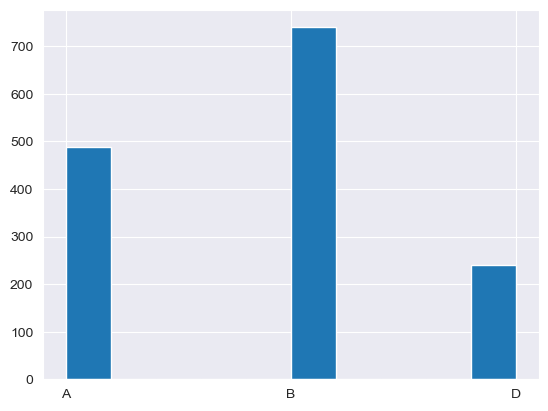

In [165]:
plt.hist(y_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'C')]);

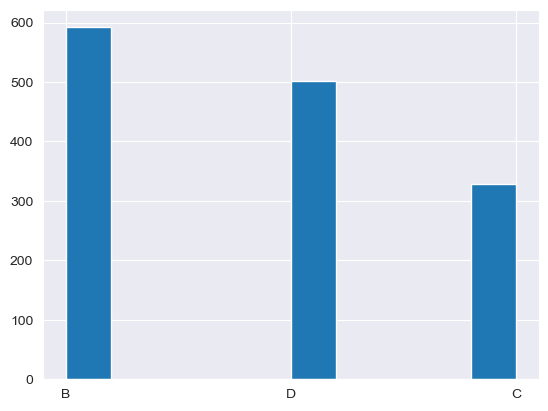

In [166]:
plt.hist(y_train[(log_clf.predict(X_train) != y_train) & (log_clf.predict(X_train) == 'A')]);

Based on the numbers and plots above, we can find that a lot of samples are mislabeled as A and C, most of which are samples whose true label is B, but we cannot find a clear pattern to explain why the prediction is wrong, except for that more than 50% of the error samples have "Cat_6" = 1. In addition, we can see that the predicted normalized probability distribution for each sample does not always have a clear cut-off between the most likely label and less likely ones, which may also explain why the mean accuracy is only about 0.469 for the training data, and 0.447 for the test data. (Another possible explanation is that the relationship between the target and the features is not linear.)

The fact that some probabilities are close to one another may be partially resulted from the increase in the number of features after one-hot encoding. Since adding variables that are highly correlated with each and variables that are not necessary can decrease the performance and the precision of the regression, some features encoded from professions and "var_1" may need to be removed from the data.

Therefore, we will
- first, analyze the result by sorting the coefficients of the four linear regressions behind the logistic regression model to find out the most important features;
- second, train a new logistic regression model using L1 regularization to penalize some of the coefficients to zero, in the hope that we can then improve the model performance by removing some less important features.
- third, train new logistic regression models on the new feature matrix and tune the parameters to see if the performance improves

#### a. Result analysis for the logistic regression model

In [167]:
coef_df = pd.DataFrame(X_train.columns)
coef_df.columns = ['Feature']
coef_df['Coefficient_A'] = log_clf.coef_[0]
coef_df.sort_values(by='Coefficient_A', ascending=False)

,Feature,Coefficient_A
10,Entertainment,0.302572
9,Engineer,0.233889
22,Cat_4,0.225468
14,Lawyer,0.180298
21,Cat_3,0.101548
16,Work_Experience,0.081832
2,Not_Married,0.076697
11,Executive,0.058223
5,Not_Grad,0.037759
1,Male,0.018747


Being in entainment professions, being engineers and being in "Cat_4" are among the top three positively correlated with being labeled class "A", while family size, healthcare and marketing professions are negatively correlated with class "A". Family size seems to be the most important feature for identifying class "A" customers.

In [168]:
coef_df = pd.DataFrame(X_train.columns)
coef_df.columns = ['Feature']
coef_df['Coefficient_B'] = log_clf.coef_[1]
coef_df.sort_values(by='Coefficient_B', ascending=False)

,Feature,Coefficient_B
4,Age,0.783996
13,Homemaker,0.275008
7,Artist,0.244154
9,Engineer,0.238041
20,Cat_2,0.197919
17,Spending_Score,0.161476
22,Cat_4,0.102088
10,Entertainment,0.101063
3,Married,0.059482
6,Grad,0.058951


Age, homemaker, artist, and engineer are positively correlated with being labeled class "B", while lawyer, healthcare, marketing and work experience are negatively correlated with "B". Among these features, age is the most important.

In [169]:
coef_df = pd.DataFrame(X_train.columns)
coef_df.columns = ['Feature']
coef_df['Coefficient_C'] = log_clf.coef_[2]
coef_df.sort_values(by='Coefficient_C', ascending=False)

,Feature,Coefficient_C
4,Age,1.094476
18,Family_Size,1.089442
7,Artist,0.679084
17,Spending_Score,0.330420
8,Doctor,0.226331
6,Grad,0.201852
24,Cat_6,0.190299
12,Healthcare,0.175978
20,Cat_2,0.147774
3,Married,0.128844


Age and family size are very positively correlated with being labeled class "C", while lawyer and "Cat_4" are negatively correlated with "C". In other words, the older you are and the larger the family you have, the more likely you are a class "C" customer.

In [170]:
coef_df = pd.DataFrame(X_train.columns)
coef_df.columns = ['Feature']
coef_df['Coefficient_D'] = log_clf.coef_[3]
coef_df.sort_values(by='Coefficient_D', ascending=False)

,Feature,Coefficient_D
14,Lawyer,0.728168
12,Healthcare,0.497578
15,Marketing,0.373462
16,Work_Experience,0.306054
5,Not_Grad,0.234083
19,Cat_1,0.140482
22,Cat_4,0.140419
2,Not_Married,0.122667
23,Cat_5,0.108497
1,Male,0.078320


Lawyer, healthcare, marketing and work experience are positively correlated with being labeled class "D", which is just the opposite for the class "B" linear model. Features most negatively correlated with "D" are age, being artists, and spending score.

In conclusion, the following are the features that are most likely to have relatively large predicitve power:
- Family size
- Age
- Entainment
- Engineers
- Healthcare
- Marketing
- Homemaker
- Artist
- Lawyer
- Cat_4
- Work experience
- Spending score.

#### b. Train a logistic regression model for classification with L1 regularization

In [171]:
log_clf_l1 = LogisticRegression(random_state=0, penalty='l1', solver='saga').fit(X_train, y_train)

In [172]:
# the mean accuracy on the training data
log_clf_l1.score(X_train, y_train)

0.46817420435510887

In [173]:
# the mean accuracy on the test data
log_clf_l1.score(X_test, y_test)

0.4483253588516746

In [174]:
# maximum number of iterations taken to converge
log_clf_l1.n_iter_

array([24], dtype=int32)

##### Result analysis for the new logistic regression model with L1 regularization

In [175]:
coef_df = pd.DataFrame(X_train.columns)
coef_df.columns = ['Feature']
coef_df['Coefficient_A'] = log_clf_l1.coef_[0]
coef_df['Coefficient_B'] = log_clf_l1.coef_[1]
coef_df['Coefficient_C'] = log_clf_l1.coef_[2]
coef_df['Coefficient_D'] = log_clf_l1.coef_[3]
coef_df

,Feature,Coefficient_A,Coefficient_B,Coefficient_C,Coefficient_D
0,Female,-0.006745,0.008953,0.019329,-0.032903
1,Male,0.009874,-0.006836,-0.170884,0.098567
2,Not_Married,0.079224,-0.068001,-0.251487,0.187911
3,Married,-0.054743,0.067360,0.023224,-0.027280
4,Age,-0.116056,0.743161,1.064395,-1.826725
5,Not_Grad,0.046093,-0.047798,-0.366751,0.428545
6,Grad,-0.039363,0.055034,0.028235,-0.042858
7,Artist,-0.164084,0.137281,0.751902,-0.857482
8,Doctor,0.000000,0.000000,0.369688,-0.197781
9,Engineer,0.202721,0.167178,-0.102730,-0.243958


In [176]:
# find out the features that has a coefficient between -0.01 and 0.01 in any of the four linear models
remove_list = []
for i in range(0, 26):
    for j in range(1, 5):
        if (coef_df.iloc[i][j] < 0.01) & (coef_df.iloc[i][j] > -0.01):
            remove_list.append(coef_df.iloc[i][0])
set(remove_list)

{'Cat_1',
 'Cat_4',
 'Cat_5',
 'Cat_6',
 'Cat_7',
 'Doctor',
 'Entertainment',
 'Executive',
 'Female',
 'Homemaker',
 'Male'}

Since we have found that "Cat_4", entainment, and homemaker are important features in the original model, we will only remove the rest.

In [177]:
remove_list = ['Cat_1', 'Cat_5', 'Cat_6', 'Cat_7', 'Doctor', 'Executive', 'Female','Male']

In [178]:
X_train_new = X_train.drop(columns=remove_list)
X_train_new.shape

(8358, 18)

In [179]:
X_test_new = X_test.drop(columns=remove_list)
X_test_new.shape

(2090, 18)

#### c. Train a logistic regression model for classification on the new data

In [180]:
log_clf_2 = LogisticRegression(random_state=0, max_iter=1000).fit(X_train_new, y_train)

In [181]:
log_clf_2.score(X_train_new, y_train)

0.46901172529313234

In [182]:
log_clf_2.score(X_test_new, y_test)

0.4502392344497608

Compared to the orginal model, the mean accuracy only improves by less than one percentage point. Therefore, we will tune the parameters to see if we can improve model performance.

###### Tune the parameters

In [183]:
# solver='liblinear'
log_clf_3 = LogisticRegression(random_state=0, max_iter=1000, solver='liblinear').fit(X_train_new, y_train)

In [184]:
# solver='newton-cg'
log_clf_4 = LogisticRegression(random_state=0, max_iter=1000, solver='newton-cg').fit(X_train_new, y_train)

In [185]:
# solver='sag'
log_clf_5 = LogisticRegression(random_state=0, max_iter=1000, solver='sag').fit(X_train_new, y_train)

In [186]:
# solver='saga'
log_clf_6 = LogisticRegression(random_state=0, max_iter=1000, solver='saga').fit(X_train_new, y_train)

In [187]:
# solver='saga', penalty='elasticnet’, l1_ratio=0.5
log_clf_7 = LogisticRegression(penalty='elasticnet', l1_ratio=0.5, random_state=0, max_iter=1000, solver='saga').fit(X_train_new, y_train)

In [188]:
# C = 2 (C defualt = 1.0, smaller values specify stronger regularization; larger values emphasize better model fit)
log_clf_8 = LogisticRegression(random_state=0, max_iter=1000, C=2).fit(X_train_new, y_train)

In [189]:
# fit_intercept=False
log_clf_9 = LogisticRegression(random_state=0, max_iter=1000, fit_intercept=False).fit(X_train_new, y_train)

In [190]:
train_accuracy = [log_clf_2.score(X_train_new, y_train), log_clf_3.score(X_train_new, y_train), log_clf_4.score(X_train_new, y_train), log_clf_5.score(X_train_new, y_train),
                  log_clf_6.score(X_train_new, y_train), log_clf_7.score(X_train_new, y_train), log_clf_8.score(X_train_new, y_train), log_clf_9.score(X_train_new, y_train)]

In [191]:
test_accuracy = [log_clf_2.score(X_test_new, y_test), log_clf_3.score(X_test_new, y_test), log_clf_4.score(X_test_new, y_test), log_clf_5.score(X_test_new, y_test),
                 log_clf_6.score(X_test_new, y_test), log_clf_7.score(X_test_new, y_test), log_clf_8.score(X_test_new, y_test), log_clf_9.score(X_test_new, y_test)]

In [192]:
accuracy_df = pd.DataFrame(train_accuracy)
accuracy_df.columns = ['train_accuracy']
accuracy_df['model_no'] = range(2, 10)
accuracy_df['test_accuracy'] = test_accuracy
accuracy_df.sort_values(by='train_accuracy', ascending=False)

,train_accuracy,model_no,test_accuracy
6,0.469251,8,0.450239
0,0.469012,2,0.450239
2,0.469012,4,0.450239
3,0.469012,5,0.450239
4,0.469012,6,0.450239
7,0.468892,9,0.450239
5,0.468413,7,0.451196
1,0.465781,3,0.444498


Based on the accuracy_df, we can find that changing the solver and removing the intercept do not really affect the mean accuracy, while setting a C value of 2 only increases the accuracy on the training data by a very small amount. Therefore, we will try set C to larger numbers.

In [193]:
# C = 5
log_clf_c5 = LogisticRegression(random_state=0, max_iter=1000, C=5).fit(X_train_new, y_train)
log_clf_c5.score(X_train_new, y_train), log_clf_c5.score(X_test_new, y_test)

(0.46960995453457766, 0.4502392344497608)

In [194]:
# C = 10
log_clf_c10 = LogisticRegression(random_state=0, max_iter=1000, C=10).fit(X_train_new, y_train)
log_clf_c10.score(X_train_new, y_train), log_clf_c10.score(X_test_new, y_test)

(0.46996889207944487, 0.4502392344497608)

In [195]:
# C = 20
log_clf_c20 = LogisticRegression(random_state=0, max_iter=1000, C=20).fit(X_train_new, y_train)
log_clf_c20.score(X_train_new, y_train), log_clf_c20.score(X_test_new, y_test)

(0.46984924623115576, 0.4502392344497608)

It is clear that setting C to larger numbers does not increase the accuracy on the test data and the effect on the accuracy for training data is quite limited.

- Conclusion for logistic regressioin model training:

All the above logistic regression models have mean accuracies around 47% for training data and around 45% for test data, regardless of the feature matrix or the parameters we use. Family size and age have relatively strong predicitive power, while gender and "Var_1" are less correlated with class labels.

Possible explanations for low mean accuracy include: (i) for multi-class targets, the predicted normalized probability distribution for each sample does not always have a clear cut-off between the most likely label and less likely ones; (ii) the relationship between the target and the features is not linear.

### Conclusion

In all the models we have trained, the random forest classifier has the higheset mean accuracy on the test data. Most important features include: Family size, Age, Spending score, Healthcare, Marketing, Homemaker.

Based on the error and result analyses, we find that class B are more likely to be misclassified than other classes in both decision tree models and logistic regression models. One possible explanation is that B is the minority category in our data.

We may improve the model performance by tuning the parameters, but can only increase the accuracy to a very limited extent. This may result from (i) lack of data for the minority categories of both features and targets, (ii) strong collinearity between some of the features, and (iii) non-linear relationship between the features and the target.

Therefore, future studies may be improved through oversampling the minority categories, better feature selection, and using non-linear models.